In [39]:
#packageları yükledik.
import numpy as np
import pandas as pd
import os
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm import tqdm_notebook
%matplotlib inline 
import cv2 as cv

In [40]:
#datayı yükledik.
DATA_FOLDER = '/Users/mevludesilakazan/Desktop/deepfake-detection-challenge'
TRAIN_SAMPLE_FOLDER = '/Users/mevludesilakazan/Desktop/train_sample_videos'
TEST_FOLDER = '/Users/mevludesilakazan/Desktop/test_videos'

print(f"Eğitim(train) veri sayısı: {len(os.listdir(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER)))}")
print(f"Test veri sayısı : {len(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER)))}")

Eğitim(train) veri sayısı: 401
Test veri sayısı : 400


In [41]:
#Ayrıca bir yüz algılama kaynağı ekledik.

FACE_DETECTION_FOLDER = '/Users/mevludesilakazan/Desktop/opencv-master/data/haarcascades'
print(f" Yüz Algılama Kaynağı: {os.listdir(FACE_DETECTION_FOLDER)}")

 Yüz Algılama Kaynağı: ['haarcascade_upperbody.xml', 'haarcascade_frontalcatface_extended.xml', 'haarcascade_profileface.xml', 'haarcascade_frontalcatface.xml', 'haarcascade_frontalface_alt2.xml', 'haarcascade_eye.xml', 'haarcascade_lefteye_2splits.xml', 'haarcascade_frontalface_alt_tree.xml', 'haarcascade_licence_plate_rus_16stages.xml', 'haarcascade_righteye_2splits.xml', 'haarcascade_frontalface_alt.xml', 'haarcascade_lowerbody.xml', 'haarcascade_russian_plate_number.xml', 'haarcascade_frontalface_default.xml', 'haarcascade_smile.xml', 'haarcascade_fullbody.xml', 'haarcascade_eye_tree_eyeglasses.xml']


In [42]:
#eğitim setinin dosya uzantılarının kontrolünü gerçekleştirdik.
#-video

train_list = list(os.listdir(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER)))
uzanti_dict = []
for file in train_list:
    file_ext = file.split('.')[1]
    if (file_ext not in uzanti_dict):
        uzanti_dict.append(file_ext)
print(f"Uzantılar: {uzanti_dict}") 

Uzantılar: ['mp4', 'json']


In [43]:
#Her uzantıya sahip kaç dosya olduğunu sayalım.
for file_ext in uzanti_dict:
    print(f" `{file_ext}` uzantılı dosyalar: {len([file for file in train_list if  file.endswith(file_ext)])}")

 `mp4` uzantılı dosyalar: 400
 `json` uzantılı dosyalar: 1


In [44]:
#Test videoları klasörü için aynı işlemi tekrarlayalım.
test_list = list(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER)))
uzanti_dict2 = []
for file in test_list:
    file_ext = file.split('.')[1]
    if (file_ext not in uzanti_dict2):
        uzanti_dict2.append(file_ext)
print(f"Uzantılar: {uzanti_dict2}")
for file_ext in uzanti_dict2:
    print(f" `{file_ext}` uzantılı dosya sayısı: {len([file for file in train_list if  file.endswith(file_ext)])}")



Uzantılar: ['mp4']
 `mp4` uzantılı dosya sayısı: 400


In [45]:
#Önce json dosyasını kontrol edelim.

json_file = [file for file in train_list if  file.endswith('json')][0]
print(f"JSON Dosyası: {json_file}")

JSON Dosyası: metadata.json


In [46]:
#Bu JSON dosyasını inceleyelim.

def get_meta_from_json(path):
    df = pd.read_json(os.path.join(DATA_FOLDER, path, json_file))
    df = df.T
    return df

meta_train_df = get_meta_from_json(TRAIN_SAMPLE_FOLDER)
meta_train_df.head()

,label,split,original
aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4
aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4
abarnvbtwb.mp4,REAL,train,None
abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4
abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4


In [47]:
#MetaData Keşfi

#Şimdi train örneğindeki meta verilerini inceleyelim.

#Missing(kayıp) değerleri kontrol ederek başlıyoruz.

def missing_data(data):
    total = data.isnull().sum()
    percent = (data.isnull().sum()/data.isnull().count()*100)
    tt = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
    types = []
    for col in data.columns:
        dtype = str(data[col].dtype)
        types.append(dtype)
    tt['Types'] = types
    return(np.transpose(tt))

In [48]:
missing_data(meta_train_df)

,label,split,original
Total,0,0,77
Percent,0,0,19.25
Types,object,object,object


In [49]:
#Örneklerin %19,25'inde (veya 77'sinde) eksik veri var.
#Aslında gerçek verilerin orijinalinin eksik olduğundan şüpheleniyoruz. 
#Bu hipotezi kontrol edelim:


missing_data(meta_train_df.loc[meta_train_df.label=='REAL'])

,label,split,original
Total,0,0,77
Percent,0,0,100
Types,object,object,object


In [50]:
#Gerçekten de, tüm missing orijinal veriler REAL etiketle ilişkilendirilen verilerdir.

#Unique Değerler

#Unique değerleri kontrol edelim.

def unique_values(data):
    total = data.count()
    tt = pd.DataFrame(total)
    tt.columns = ['Total']
    uniques = []
    for col in data.columns:
        unique = data[col].nunique()
        uniques.append(unique)
    tt['Uniques'] = uniques
    return(np.transpose(tt))

In [51]:
unique_values(meta_train_df)

,label,split,original
Total,400,400,323
Uniques,2,1,209


In [52]:
#Orijinal etiketin unique değerler için aynı patterne sahip olduğunu gözlemliyoruz.
#77 eksik verimiz olduğunu biliyoruz (bu nedenle toplam sadece 323'tür) ve 209 benzersiz örneğimiz olduğunu gözlemliyoruz.

#En Sık Kullanılan Orijinaller:

def most_frequent_values(data):
    total = data.count()
    tt = pd.DataFrame(total)
    tt.columns = ['Total']
    items = []
    vals = []
    for col in data.columns:
        itm = data[col].value_counts().index[0]
        val = data[col].value_counts().values[0]
        items.append(itm)
        vals.append(val)
    tt['En çok kullanılan item'] = items
    tt['Sıklık'] = vals
    tt['Totaldeki yüzdesi'] = np.round(vals / total * 100, 3)
    return(np.transpose(tt))

In [53]:
most_frequent_values(meta_train_df)

,label,split,original
Total,400,400,323
En çok kullanılan item,FAKE,train,atvmxvwyns.mp4
Sıklık,323,400,6
Totaldeki yüzdesi,80.75,100,1.858


In [54]:
#En sık kullanılan etiketin FAKE (%80,75) olduğunu ve
#meawmsgiti.mp4'ün en sık kullanılan orijinal olduğunu görüyoruz.


#Şimdi bazı görselleştirmeler yapalım.


def plot_count(feature, title, df, size=1):
    f, ax = plt.subplots(1,1, figsize=(4*size,4))
    total = float(len(df))
    g = sns.countplot(df[feature], order = df[feature].value_counts().index[:20], palette='Set3')
    g.set_title("{} sayısı ve yüzdesi".format(title))
    if(size > 2):
        plt.xticks(rotation=90, size=8)
    for p in ax.patches:
        height = p.get_height()
        ax.text(p.get_x()+p.get_width()/2.,
                height + 3,
                '{:1.2f}%'.format(100*height/total),
                ha="center") 
    plt.show()    

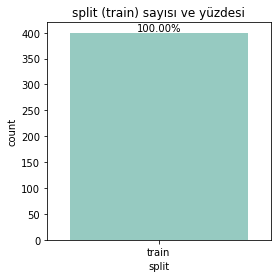

In [55]:
plot_count('split', 'split (train)', meta_train_df)

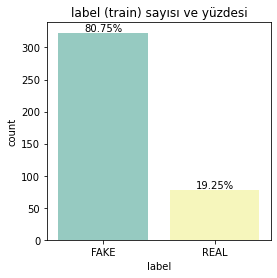

In [56]:
plot_count('label', 'label (train)', meta_train_df)

In [57]:
#Gördüğümüz gibi, FAKE'lerin %80,75'ini oluşturduğu 
#train videolarında GERÇEK sadece %19,25'tir.

#Video Veri Keşfi

#Eksik video (veya meta) verileri

#Önce meta bilgideki dosya listesi ile klasördeki listenin 
#aynı olup olmadığını kontrol ediyoruz.

meta = np.array(list(meta_train_df.index))
storage = np.array([file for file in train_list if  file.endswith('mp4')])
print(f"Metadata: {meta.shape[0]}, Klasör: {storage.shape[0]}")
print(f"Metadatada olan ve klasörde olmayan dosyalar: {np.setdiff1d(meta,storage,assume_unique=False).shape[0]}")
print(f"Klasörde olan ve metadatada olmayan dosyalar: {np.setdiff1d(storage,meta,assume_unique=False).shape[0]}")

Metadata: 400, Klasör: 400
Metadatada olan ve klasörde olmayan dosyalar: 0
Klasörde olan ve metadatada olmayan dosyalar: 0


In [58]:
"""Şimdi verileri görselleştirelim.

Önce sahte videoların bir listesini seçiyoruz."""

fake_train_sample_video = list(meta_train_df.loc[meta_train_df.label=='FAKE'].sample(3).index)
fake_train_sample_video

['aufmsmnoye.mp4', 'agqphdxmwt.mp4', 'aqpnvjhuzw.mp4']

In [59]:
def display_image_from_video(video_path):
    '''
    1. videodan bir kare çekimi gerçekleştir
    2. kareyi yani resmi oku
    3. görüntüyü göster
    '''
    capture_image = cv.VideoCapture(video_path) 
    ret, frame = capture_image.read()
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    frame = cv.cvtColor(frame, cv.COLOR_BGR2RGB)
    ax.imshow(frame)

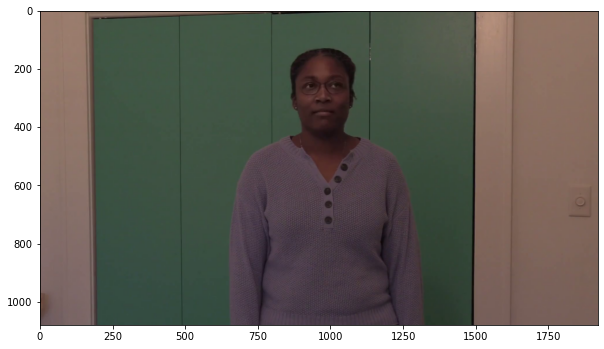

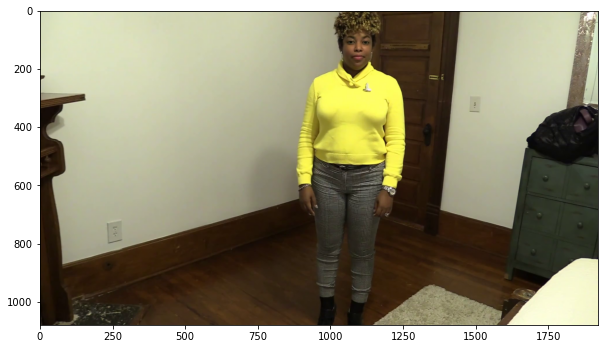

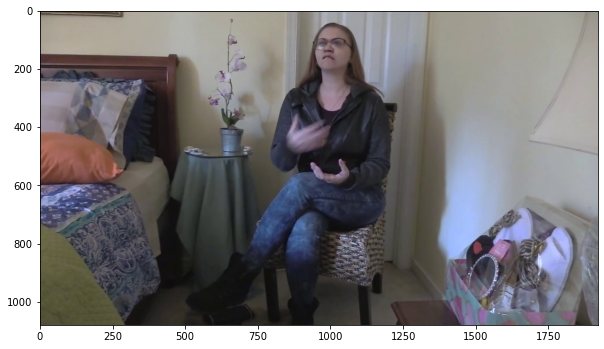

In [60]:
for video_file in fake_train_sample_video:
    display_image_from_video(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file))

In [61]:
#Şimdi aynısını gerçek olan birkaç görüntü için deneyelim.

real_train_sample_video = list(meta_train_df.loc[meta_train_df.label=='REAL'].sample(3).index)
real_train_sample_video

['aytzyidmgs.mp4', 'dakiztgtnw.mp4', 'bpapbctoao.mp4']

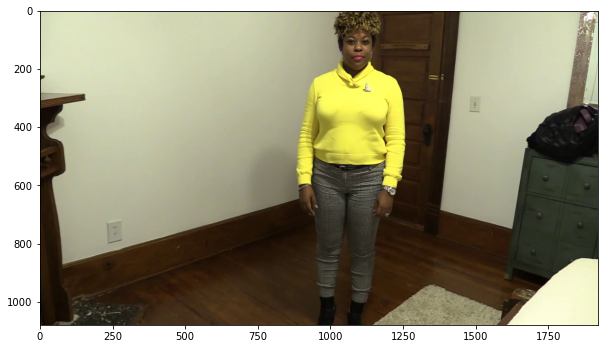

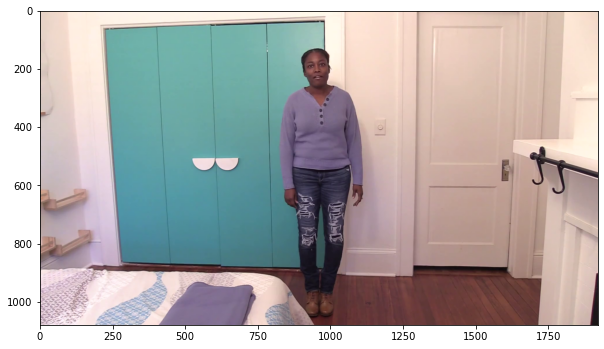

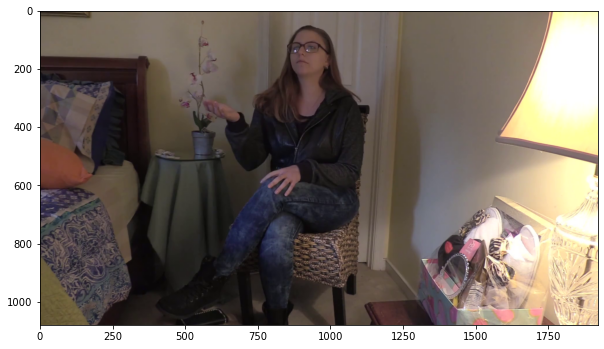

In [62]:
for video_file in real_train_sample_video:
    display_image_from_video(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file))

In [63]:
#Aynı Orijinale Sahip Videolar


#Şimdi aynı orijinale sahip örnekler kümesine bakalım.

meta_train_df['original'].value_counts()[0:5]

atvmxvwyns.mp4    6
meawmsgiti.mp4    6
qeumxirsme.mp4    5
kgbkktcjxf.mp4    5
fysyrqfguw.mp4    4
Name: original, dtype: int64

In [64]:
#En fazla sayıda numuneye sahip orijinallerden birini seçiyoruz.

#Ayrıca görselleştirme fonksiyonumuzu birden fazla 
#görüntüyle çalışacak şekilde değiştiriyoruz.

def display_image_from_video_list(video_path_list, video_folder=TRAIN_SAMPLE_FOLDER):
    '''
        0. video yolu listesindeki her video için,
        1. videodan bir kare çekimi gerçekleştirin
        2. kareyi yani resmi oku
        3. görüntüyü göster
    '''
    plt.figure()
    fig, ax = plt.subplots(2,3,figsize=(16,8))
    # sadece ilk 6 videodan alınan görüntüleri gösteriyoruz
    for i, video_file in enumerate(video_path_list[0:6]):
        video_path = os.path.join(DATA_FOLDER, video_folder,video_file)
        capture_image = cv.VideoCapture(video_path) 
        ret, frame = capture_image.read()
        frame = cv.cvtColor(frame, cv.COLOR_BGR2RGB)
        ax[i//3, i%3].imshow(frame)
        ax[i//3, i%3].set_title(f"Video: {video_file}")
        ax[i//3, i%3].axis('on')

<Figure size 432x288 with 0 Axes>

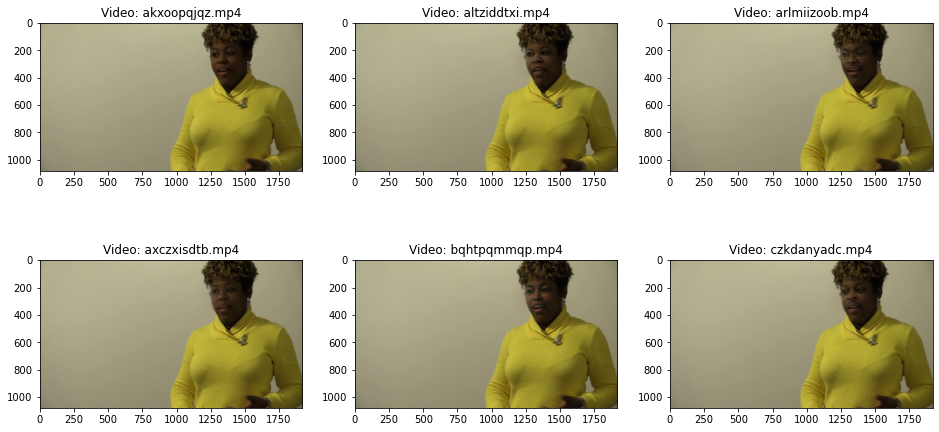

In [65]:
same_original_fake_train_sample_video = list(meta_train_df.loc[meta_train_df.original=='meawmsgiti.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

<Figure size 432x288 with 0 Axes>

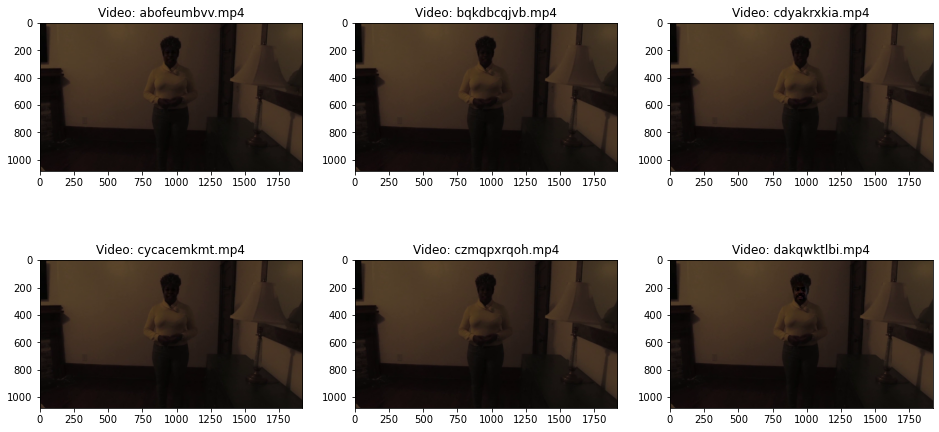

In [66]:
#Şimdi aynı orijinale sahip farklı video seçeneklerine bakalım.

same_original_fake_train_sample_video = list(meta_train_df.loc[meta_train_df.original=='atvmxvwyns.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

<Figure size 432x288 with 0 Axes>

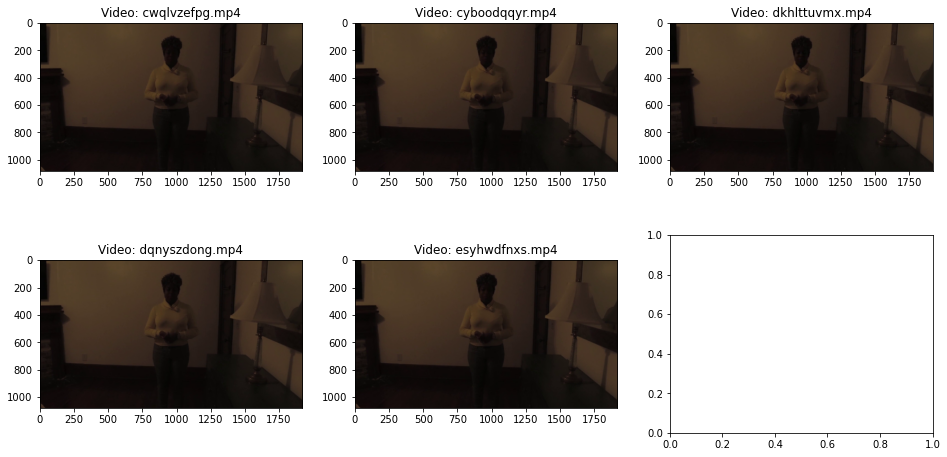

In [67]:
same_original_fake_train_sample_video = list(meta_train_df.loc[meta_train_df.original=='qeumxirsme.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

<Figure size 432x288 with 0 Axes>

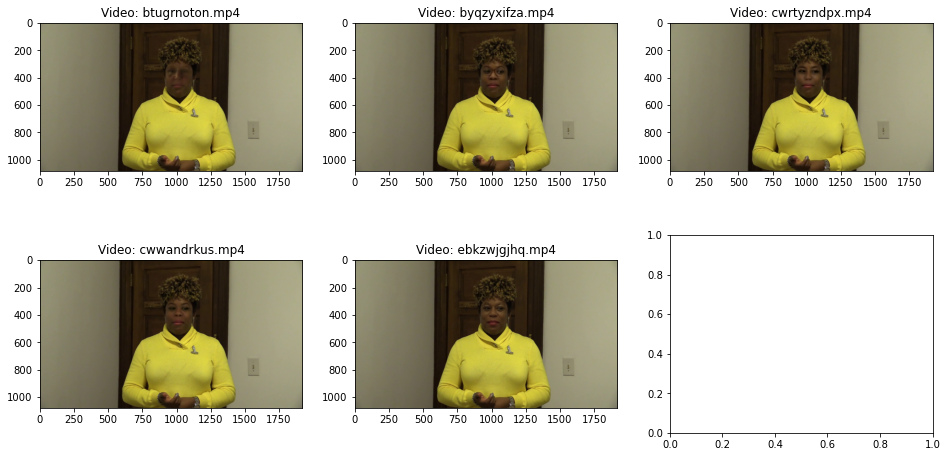

In [68]:
same_original_fake_train_sample_video = list(meta_train_df.loc[meta_train_df.original=='kgbkktcjxf.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

In [69]:
#Ayrıca birkaç test veri dosyasına bakalım.

test_videos = pd.DataFrame(list(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER))), columns=['video'])

In [70]:
test_videos.head()

,video
0,qyyhuvqmyf.mp4
1,sfsayjgzrh.mp4
2,novarhxpbj.mp4
3,xljemofssi.mp4
4,nxnmkytwze.mp4


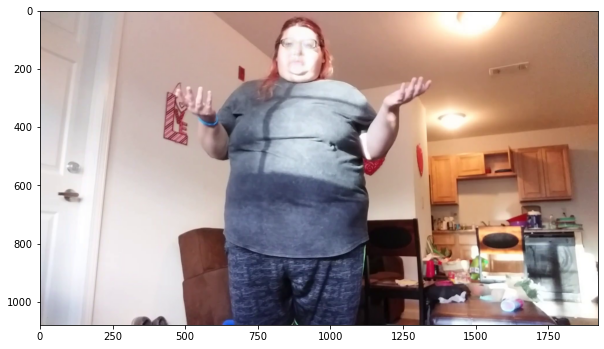

In [71]:
#Şimdi videolardan birini görselleştirelim.

display_image_from_video(os.path.join(DATA_FOLDER, TEST_FOLDER, test_videos.iloc[0].video))

<Figure size 432x288 with 0 Axes>

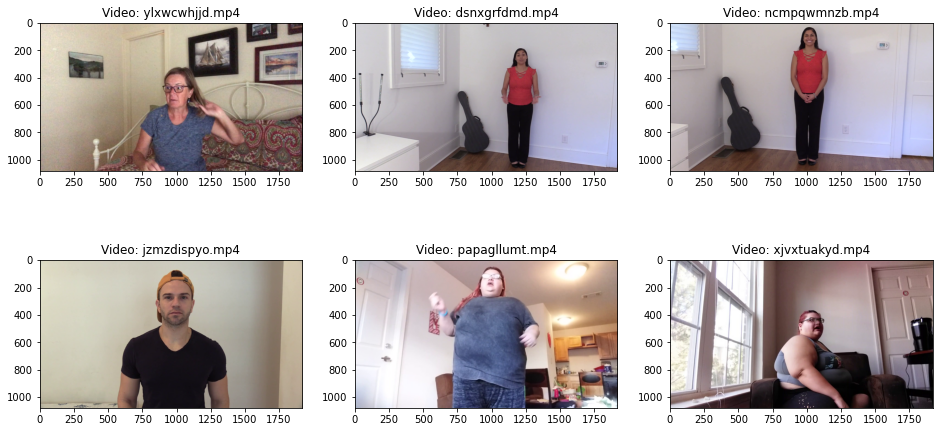

In [72]:
#Test setinden birkaç video daha izleyelim.

display_image_from_video_list(test_videos.sample(6).video, TEST_FOLDER)

In [73]:
#Yüz Tanıma

# 'ObjectDetector' sınıfı, kademeli(cascade) sınıflandırıcıyı başlatır (içe aktarılan kaynağı kullanarak). 
#Algılama işlevi, nesneleri bu durumda yüz, göz, gülümseme veya profil yüzü gibi görüntülerde algılamak için CascadeClassifier'ın bir yöntemini kullanır.


class ObjectDetector():
  
    def __init__(self,object_cascade_path):
      

        self.objectCascade=cv.CascadeClassifier(object_cascade_path)


    def detect(self, image, scale_factor=1.3,
               min_neighbors=5,
               min_size=(20,20)):
        '''
        Verilen görüntü için nesnenin fonksiyon dönüş dikdörtgen koordinatları
        param: görüntü - işlenecek görüntü
        param: scale_factor - nesne algılama için kullanılan ölçek faktörü
        param: min_neighbors - nesne algılama sırasında dikkate alınan minimum parametre sayısı
        param: min_size - algılanan nesne için minimum sınırlayıcı kutu boyutu
        '''
       
        rects=self.objectCascade.detectMultiScale(image,
                                                scaleFactor=scale_factor,
                                                minNeighbors=min_neighbors,
                                                minSize=min_size)
        return rects

In [74]:
"""Ön yüz, göz, gülümseme ve profil yüz algılama 
için kaynakları yüklüyoruz.

Ardından, her belirli görev için CascadeClassfier 
kullanmak üzere yukarıda tanımlanan ObjectDetector 
nesnelerini ilgili kaynaklarla başlatırız."""


#Ön yüz, profil, göz ve gülümseme yüklendi
frontal_cascade_path= os.path.join(FACE_DETECTION_FOLDER,'haarcascade_frontalface_default.xml')
eye_cascade_path= os.path.join(FACE_DETECTION_FOLDER,'haarcascade_eye.xml')
profile_cascade_path= os.path.join(FACE_DETECTION_FOLDER,'haarcascade_profileface.xml')
smile_cascade_path= os.path.join(FACE_DETECTION_FOLDER,'haarcascade_smile.xml')

#Detector nesnesi oluşturuldu
# ön yüz
fd=ObjectDetector(frontal_cascade_path)
# göz
ed=ObjectDetector(eye_cascade_path)
# profil
pd=ObjectDetector(profile_cascade_path)
# gülümseme
sd=ObjectDetector(smile_cascade_path)

In [75]:
"""Ayrıca tüm bu belirli nesnelerin algılanması ve görüntülenmesi
için bir fonksiyon tanımlıyoruz.

İşlev, ObjectDetector nesnesinin algılama yöntemini çağırır.
Her nesne için aşağıdaki gibi farklı bir şekil ve renk kullanıyoruz:

Ön yüz: yeşil dikdörtgen;
Göz: kırmızı daire;
Gülümseme: kırmızı dikdörtgen;
Profil yüzü: mavi dikdörtgen.

Not: Büyük miktarda false positive nedeniyle gülümseme
dedektörünü şimdilik devre dışı bırakıyoruz."""

def detect_objects(image, scale_factor, min_neighbors, min_size):
    '''
    Nesne algılama işlevi
    Ön yüzü, gözleri, gülümsemeyi ve profil yüzünü tanımlayın ve algılanan nesneleri görüntü üzerinde görüntüleyin
    param: görüntü - videodan çıkarılan görüntü
    param: scale_factor - ObjectDetector nesnesinin "tespit" işlevi için ölçek faktörü parametresi
    param: min_neighbors - ObjectDetector nesnesinin "algılama" işlevi için en az komşu parametresi
    param: min_size - ObjectDetector nesnesinin f`detect` işlevi için minimum boyut parametresi
    '''
    
    image_gray=cv.cvtColor(image, cv.COLOR_BGR2GRAY)


    eyes=ed.detect(image_gray,
                   scale_factor=scale_factor,
                   min_neighbors=min_neighbors,
                   min_size=(int(min_size[0]/2), int(min_size[1]/2)))

    for x, y, w, h in eyes:
        #renkli görüntüde gösterilen algılanan gözler
        cv.circle(image,(int(x+w/2),int(y+h/2)),(int((w + h)/4)),(0, 0,255),3)
 
    

    profiles=pd.detect(image_gray,
                   scale_factor=scale_factor,
                   min_neighbors=min_neighbors,
                   min_size=min_size)

    for x, y, w, h in profiles:
        #renkli görüntüde gösterilen algılanan profiller
        cv.rectangle(image,(x,y),(x+w, y+h),(255, 0,0),3)

    faces=fd.detect(image_gray,
                   scale_factor=scale_factor,
                   min_neighbors=min_neighbors,
                   min_size=min_size)

    for x, y, w, h in faces:
        #renkli görüntüde gösterilen algılanan yüzler
        cv.rectangle(image,(x,y),(x+w, y+h),(0, 255,0),3)

    # image
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    image = cv.cvtColor(image, cv.COLOR_BGR2RGB)
    ax.imshow(image)

In [76]:
#Aşağıdaki işlev, bir videodan bir görüntü çıkarır ve 
#ardından görüntüden yüz dikdörtgenini çıkaran ve 
#dikdörtgeni görüntünün üzerinde görüntüleyen işlevi çağırır.

def extract_image_objects(video_file, video_set_folder=TRAIN_SAMPLE_FOLDER):
    '''
    Videodan bir görüntü çıkarıp ve görüntü üzerinde yüz/göz/gülümseme/profil algılama gerçekleştirelim.
    param: video_file - yüzü çıkardığımız görüntünün çıkarılacağı video
    '''
    video_path = os.path.join(DATA_FOLDER, video_set_folder,video_file)
    capture_image = cv.VideoCapture(video_path) 
    ret, frame = capture_image.read()
    #frame = cv.cvtColor(frame, cv.COLOR_BGR2RGB)
    detect_objects(image=frame, 
            scale_factor=1.3, 
            min_neighbors=5, 
            min_size=(50, 50)) 

byqzyxifza.mp4
cwrtyzndpx.mp4
cwwandrkus.mp4


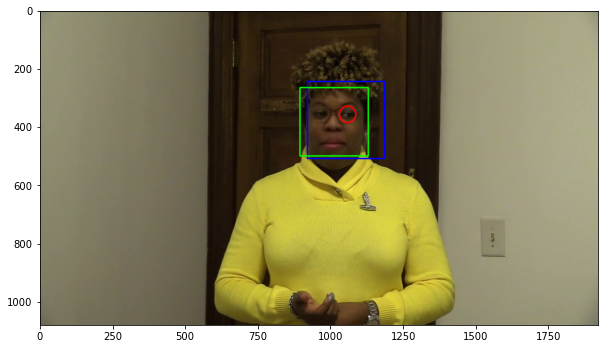

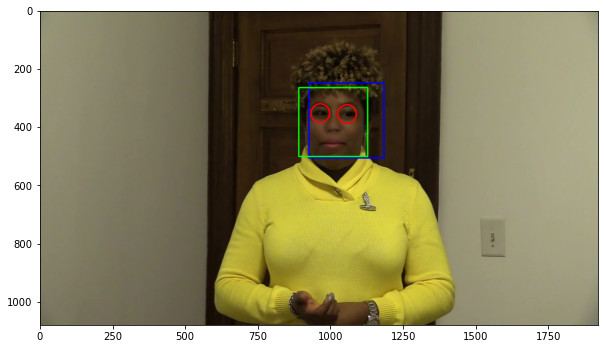

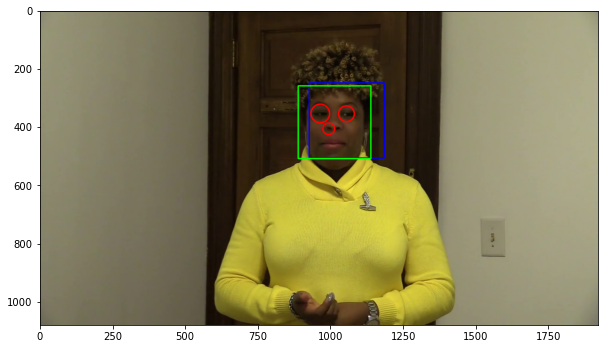

In [77]:
#Train videolarından bir dizi görüntü için
#yüz algılama işlevini uyguluyoruz.

same_original_fake_train_sample_video = list(meta_train_df.loc[meta_train_df.original=='kgbkktcjxf.mp4'].index)
for video_file in same_original_fake_train_sample_video[1:4]:
    print(video_file)
    extract_image_objects(video_file)

asaxgevnnp.mp4
etdcqxabww.mp4
doanjploai.mp4


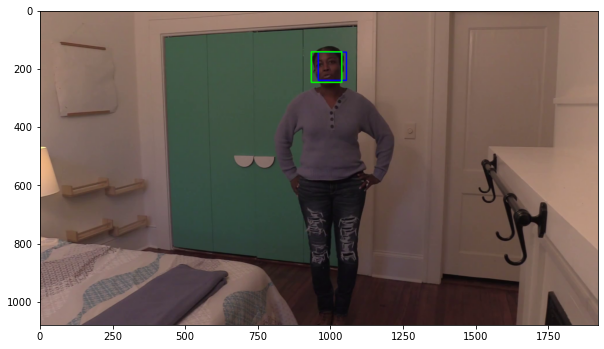

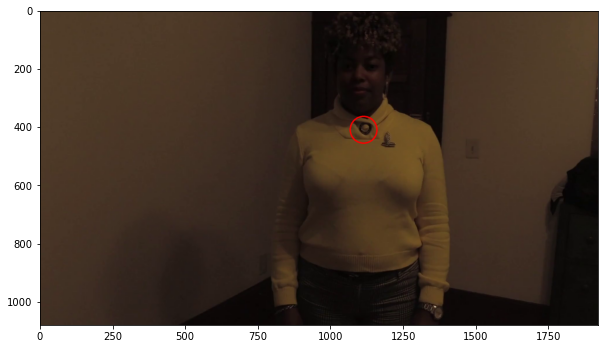

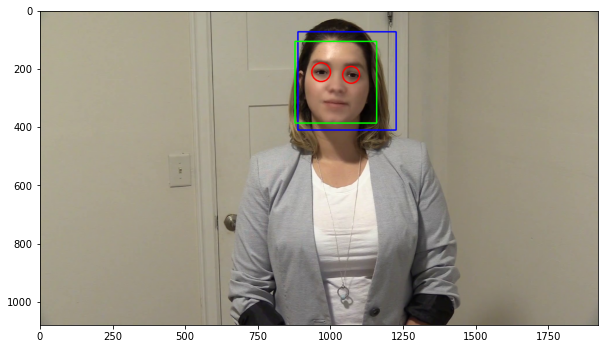

In [78]:
train_subsample_video = list(meta_train_df.sample(3).index)
for video_file in train_subsample_video:
    print(video_file)
    extract_image_objects(video_file)

dvwpvqdflx.mp4
shnsajrsow.mp4
ghnpsltzyn.mp4


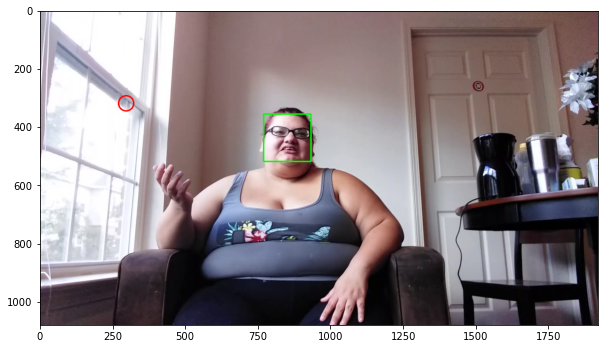

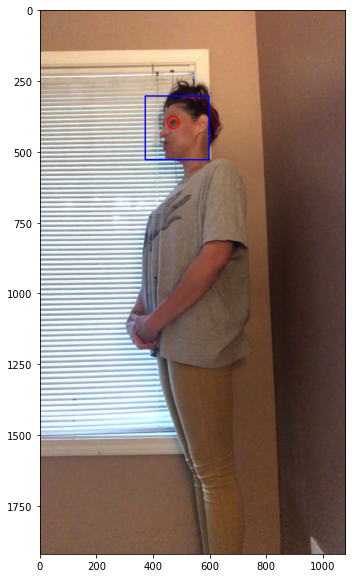

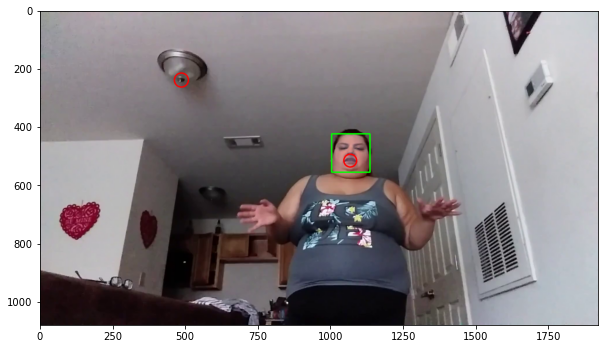

In [79]:
#Test videolarından küçük bir örnek koleksiyonuna bakalım.

subsample_test_videos = list(test_videos.sample(3).video)
for video_file in subsample_test_videos:
    print(video_file)
    extract_image_objects(video_file, TEST_FOLDER)

In [80]:
"""Bazı durumlarda, özne önden bakmadığında veya parlaklığı düşük 
olduğunda, yüz algılama algoritmasının yüzü veya gözleri doğru
algılamadığını gözlemleyebiliriz. 

Büyük miktarda false positive nedeniyle 
gülümseme dedektörünü şimdilik devre dışı bıraktık."""

#Video dosyalarını oynatalım.

fake_videos = list(meta_train_df.loc[meta_train_df.label=='FAKE'].index)

In [81]:
from IPython.display import HTML
from base64 import b64encode

def play_video(video_file, subset=TRAIN_SAMPLE_FOLDER):

    video_url = open(os.path.join(DATA_FOLDER, subset,video_file),'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(video_url).decode()
    return HTML("""<video width=500 controls><source src="%s" type="video/mp4"></video>""" % data_url)

In [82]:
play_video(fake_videos[0])

In [83]:
play_video(fake_videos[11])

In [84]:
play_video(fake_videos[8])

In [85]:
play_video(fake_videos[10])

In [86]:
"""
Bu sahte videoların görsel incelemesinden, bazı durumlarda 
derin sahte mühendislik yapılırken oluşturulan anormallikleri
tespit etmek çok kolaydır, bazı durumlarda daha zordur."""



'\nBu sahte videoların görsel incelemesinden, bazı durumlarda \nderin sahte mühendislik yapılırken oluşturulan anormallikleri\ntespit etmek çok kolaydır, bazı durumlarda daha zordur.'